In [ ]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK./root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1
# /content/labels_with_dont_care
import kagglehub
klemenko_kitti_dataset_path = kagglehub.dataset_download('klemenko/kitti-dataset')

print('Data source import complete.')


Data source import complete.


In [ ]:
!pip install ultralytics

In [ ]:
print(klemenko_kitti_dataset_path)




/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1


In [ ]:
# YOLOv8 Object Detection Training Script for KITTI Dataset
import os
import shutil
import yaml
import random
import torch
import numpy as np
from pathlib import Path
from PIL import Image
from sklearn.model_selection import train_test_split
from ultralytics import YOLO

# 1. Setup and Configuration

In [ ]:
import torch
from pathlib import Path

KITTI_BASE_DIR = '/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1'
"""str: The base directory where the KITTI dataset is located."""

IMAGE_DIR = Path(KITTI_BASE_DIR) / 'data_object_image_2' / 'training' / 'image_2'
"""Path: Directory containing KITTI training images."""

LABEL_DIR = Path(KITTI_BASE_DIR) / 'data_object_label_2' / 'training' / 'label_2'
"""Path: Directory containing KITTI training labels."""

TRAIN_DIR = Path(KITTI_BASE_DIR)/'train'
"""Path: Directory where training images and labels will be stored in YOLOv5 format."""

VALID_DIR = Path(KITTI_BASE_DIR)/'valid'
"""Path: Directory where validation images and labels will be stored in YOLOv5 format."""

LABELS_DIR = Path(KITTI_BASE_DIR)/'labels_with_dont_care'
"""Path: Directory where YOLOv5-formatted labels will be stored."""

CLASSES = [
    'Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting',
    'Cyclist', 'Tram', 'Misc', 'DontCare'
]
"""
list of str: List of class names included in the KITTI dataset.
'CLASSES' should reflect all possible object categories for detection.
"""

# YOLOv5 model configuration (YOLOv5 uses .yaml files for model config)
MODEL_ARCH = 'yolov5s.yaml'  # Example, adjust according to your variant
"""str: The YOLOv5 model configuration file to use."""

EPOCHS = 50
"""int: Number of epochs for training. Adjust this value based on dataset size and desired training time."""

BATCH_SIZE = 16
"""int: Batch size used during training. Adjust based on GPU memory constraints."""

IMG_SIZE = 640
"""int: The size (height and width) of the input images for the model."""

CONFIDENCE_THRESHOLD = 0.25
"""float: The confidence threshold for predictions during validation and testing."""

PROJECT_NAME = 'YOLOv5-KITTI'
"""str: The name of the project folder where YOLOv5 results will be saved."""

EXPERIMENT_NAME = 'exp1'
"""str: The name of the experiment folder within the project directory to store this run's results."""

device = 'cuda' if torch.cuda.is_available() else 'cpu'
"""str: The device to use for training and inference, defaults to GPU if available."""

print(f"Using device: {device}")



Using device: cuda


# 2. Data Preparation Functions

In [ ]:
from PIL import Image
from pathlib import Path

CLASSES = [
    'Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting',
    'Cyclist', 'Tram', 'Misc', 'DontCare'
]
"""
List of class names included in the KITTI dataset.
'CLASSES' should reflect all possible object categories for detection.
"""

CLAZZ_NUMBERS = {name: idx for idx, name in enumerate(CLASSES)}
"""
dict: A mapping from class names to numeric labels.
The numeric labels are used by YOLO for class indices.
"""

def convert_bbox_to_yolo(bbox, size):
    """
    Convert KITTI bounding box coordinates to YOLO format.

    Args:
        bbox (tuple of float): Bounding box coordinates in the format (left, right, top, bottom).
        size (tuple of int): Image size as (width, height).

    Returns:
        tuple of float: YOLO-formatted bounding box as (x_center, y_center, width, height) normalized by image size.
    """
    dw = 1.0 / size[0]
    dh = 1.0 / size[1]
    x_center = (bbox[0] + bbox[1]) / 2.0
    y_center = (bbox[2] + bbox[3]) / 2.0
    width = bbox[1] - bbox[0]
    height = bbox[3] - bbox[2]
    x_center *= dw
    width *= dw
    y_center *= dh
    height *= dh
    return x_center, y_center, width, height

def parse_kitti_label_file(lbl_path, img_path):
    """
    Parse a KITTI label file and convert the bounding boxes to YOLOv5 format.

    Args:
        lbl_path (Path): Path to the KITTI label file (in KITTI text format).
        img_path (Path): Path to the corresponding image file.

    Returns:
        list of tuple: A list of YOLOv5-formatted bounding boxes. Each element is
        (class_idx, x_center, y_center, width, height).
    """
    with open(lbl_path, 'r', encoding='utf-8') as file:
        lines = file.read().strip().split('\n')

    yolo_labels = []
    if not img_path.exists():
        # If the image doesn't exist, skip processing labels
        return yolo_labels

    img_size = Image.open(img_path).size  # (width, height)

    for line in lines:
        parts = line.split()
        clazz = parts[0]
        if clazz not in CLAZZ_NUMBERS:
            # Skip classes not in our mapping
            continue

        # KITTI format:
        # type, truncated, occluded, alpha, bbox_left, bbox_top, bbox_right, bbox_bottom, ...
        # Indices:  0    ,    1     ,   2     ,   3  ,    4     ,    5    ,     6     ,      7    ...
        # Example: Car 0.00 0 1.57 148.00 174.00 350.00 325.00 ...
        # The bounding box coordinates: left = parts[4], top = parts[5], right = parts[6], bottom = parts[7]
        bbox_left = float(parts[4])
        bbox_top = float(parts[5])
        bbox_right = float(parts[6])
        bbox_bottom = float(parts[7])
        bbox = (bbox_left, bbox_right, bbox_top, bbox_bottom)

        # Convert bounding box to YOLO format (normalized)
        x_center, y_center, width, height = convert_bbox_to_yolo(bbox, img_size)
        clazz_number = CLAZZ_NUMBERS[clazz]

        # YOLO format: class x_center y_center width height
        yolo_labels.append((clazz_number, x_center, y_center, width, height))

    return yolo_labels



# 3. Generate YOLO labels

In [ ]:
if not LABELS_DIR.exists():
    LABELS_DIR.mkdir()

image_paths = sorted(list(IMAGE_DIR.glob('*.png')))
label_paths = sorted(list(LABEL_DIR.glob('*.txt')))

for img_path in image_paths:
    lbl_path = LABEL_DIR / f"{img_path.stem}.txt"
    if lbl_path.exists():
        yolo_labels = parse_kitti_label_file(lbl_path, img_path)
        yolo_label_path = LABELS_DIR / f"{img_path.stem}.txt"
        with open(yolo_label_path, 'w', encoding='utf-8') as lf:
            for lbl in yolo_labels:
                lf.write(" ".join(f"{val:.6f}" for val in lbl) + "\n")

print("YOLO format labels have been generated in:", LABELS_DIR.resolve())

YOLO format labels have been generated in: /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/labels_with_dont_care


# 4. Split Dataset into Train and Validation Sets

In [ ]:
labels_for_images = [(img_path, LABELS_DIR / f"{img_path.stem}.txt")
                     for img_path in image_paths
                     if (LABELS_DIR / f"{img_path.stem}.txt").exists()]

train_pairs, valid_pairs = train_test_split(
    labels_for_images,
    test_size=0.1,
    random_state=42,
    shuffle=True
)
print(f"Training samples: {len(train_pairs)}, Validation samples: {len(valid_pairs)}")

# Create directories for YOLO data structure:
for folder in [TRAIN_DIR, VALID_DIR]:
    if folder.exists():
        shutil.rmtree(folder)
    folder.mkdir()
    (folder / 'images').mkdir()
    (folder / 'labels').mkdir()

for img_path, lbl_path in train_pairs:
    shutil.copy(img_path, TRAIN_DIR / 'images' / img_path.name)
    shutil.copy(lbl_path, TRAIN_DIR / 'labels' / lbl_path.name)

for img_path, lbl_path in valid_pairs:
    shutil.copy(img_path, VALID_DIR / 'images' / img_path.name)
    shutil.copy(lbl_path, VALID_DIR / 'labels' / lbl_path.name)

print(f"Training data copied to {TRAIN_DIR / 'images'} and {TRAIN_DIR / 'labels'}")
print(f"Validation data copied to {VALID_DIR / 'images'} and {VALID_DIR / 'labels'}")

Training samples: 6732, Validation samples: 749
Training data copied to /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/images and /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/labels
Validation data copied to /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images and /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/labels


# 5. Create data.yaml File for YOLO

In [ ]:
import yaml
from pathlib import Path

# Define your class names
CLASSES = [
    'Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting',
    'Cyclist', 'Tram', 'Misc', 'DontCare'
]  # Replace with your actual class names

# Update with the actual paths where you moved your dataset
# These should match the paths in cell 52
TRAIN_DIR = Path(KITTI_BASE_DIR) / 'train' / 'images'
VALID_DIR = Path(KITTI_BASE_DIR) / 'valid' / 'images'

# Define the path for the data.yaml file
DATA_CONFIG = '/content/data.yaml'

# Prepare the data configuration dictionary
data_config = {
    'train': str(TRAIN_DIR.resolve()),  # Absolute path to train images
    'val': str(VALID_DIR.resolve()),    # Absolute path to validation images
    'nc': len(CLASSES),                 # Number of classes
    'names': CLASSES                    # List of class names
}

# Write the data configuration to the data.yaml file
with open(DATA_CONFIG, 'w', encoding='utf-8') as f:
    yaml.dump(data_config, f, default_flow_style=False)

# Output the content of the generated data.yaml file
print("data.yaml file created with content:")
print(data_config)

data.yaml file created with content:
{'train': '/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/images', 'val': '/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images', 'nc': 9, 'names': ['Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting', 'Cyclist', 'Tram', 'Misc', 'DontCare']}


In [ ]:

!pip install yolov5

# 6. Train the YOLO11 Model

In [ ]:
# Clone the YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5.git

# Install dependencies
!pip install -r yolov5/requirements.txt

# Navigate to the repository
%cd yolov5


fatal: destination path 'yolov5' already exists and is not an empty directory.
/content/yolov5


MODEL ARCHITECTURE


In [ ]:
from ultralytics import YOLO
import torch

# Define configuration
MODEL_ARCH = 'su'  # Updated to 'su' for the yolov5su model
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Define the training parameters
DATA_CONFIG = '/content/data.yaml'  # Path to the generated data.yaml
EPOCHS = 5  # Adjusted to 50 as per the original input
BATCH_SIZE = 16  # Same as before
IMG_SIZE = 640  # Image size remains 640
CONFIDENCE_THRESHOLD = 0.25  # Confidence threshold for validation

PROJECT_NAME = 'YOLOv5-KITTI'  # Project folder name
EXPERIMENT_NAME = 'exp1'  # Experiment name

# Initialize the model
model = YOLO(f'yolov5su.pt').to(device)

# Train the model
train_results = model.train(
    data=DATA_CONFIG,
    epochs=EPOCHS,
    batch=BATCH_SIZE,
    imgsz=IMG_SIZE,
    project=PROJECT_NAME,
    name=EXPERIMENT_NAME,
    device=device,
    exist_ok=True
)

print("\nTraining completed!\n")


Ultralytics 8.3.57 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov5su.pt, data=/content/data.yaml, epochs=5, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=8, project=YOLOv5-KITTI, name=exp1, exist_ok=True, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=T

train: Scanning /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/labels... 6732 images, 0 backgrounds, 0 corrupt: 100%|██████████| 6732/6732 [00:54<00:00, 124.25it/s]


train: New cache created: /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.24 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/labels... 749 images, 0 backgrounds, 0 corrupt: 100%|██████████| 749/749 [00:05<00:00, 134.78it/s]

val: New cache created: /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/labels.cache


Plotting labels to YOLOv5-KITTI/exp1/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000769, momentum=0.9) with parameter groups 69 weight(decay=0.0), 76 weight(decay=0.0005), 75 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to YOLOv5-KITTI/exp1
Starting training for 5 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/5      4.06G      1.344      1.355      1.084        246        640: 100%|██████████| 421/421 [04:11<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:15<00:00,  1.53it/s]


                   all        749       5425        0.5      0.484      0.481      0.283

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/5      4.39G      1.251     0.9677      1.047        162        640: 100%|██████████| 421/421 [04:03<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.85it/s]


                   all        749       5425      0.549      0.482      0.535      0.319

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/5      4.24G      1.203     0.8891      1.034        125        640: 100%|██████████| 421/421 [04:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.83it/s]


                   all        749       5425      0.575      0.556      0.572      0.362

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/5      4.37G      1.154     0.8253      1.012        174        640: 100%|██████████| 421/421 [03:59<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:14<00:00,  1.61it/s]


                   all        749       5425      0.556      0.604      0.626      0.402

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/5      4.17G       1.09     0.7521     0.9897        158        640: 100%|██████████| 421/421 [03:56<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:14<00:00,  1.63it/s]

                   all        749       5425      0.688      0.625      0.674       0.44



5 epochs completed in 0.363 hours.
Optimizer stripped from YOLOv5-KITTI/exp1/weights/last.pt, 18.5MB
Optimizer stripped from YOLOv5-KITTI/exp1/weights/best.pt, 18.5MB

Validating YOLOv5-KITTI/exp1/weights/best.pt...
Ultralytics 8.3.57 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv5s summary (fused): 193 layers, 9,115,019 parameters, 0 gradients, 23.8 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:15<00:00,  1.56it/s]


                   all        749       5425       0.69      0.624      0.674       0.44
                   Car        678       3040      0.775      0.913      0.937      0.706
                   Van        223        296      0.789       0.73      0.802      0.579
                 Truck        102        104      0.797      0.875      0.887       0.69
            Pedestrian        179        441      0.727      0.644      0.707      0.382
        Person_sitting         12         25      0.435       0.44      0.387      0.188
               Cyclist        124        174      0.845      0.563      0.707      0.391
                  Tram         29         56      0.734      0.768      0.828      0.528
                  Misc         75         91      0.674       0.59      0.629      0.437
              DontCare        567       1198      0.437     0.0935      0.183     0.0575
Speed: 0.2ms preprocess, 2.2ms inference, 0.0ms loss, 3.0ms postprocess per image
Results saved to YOLOv5-KITT

# 7. Validate the Model

In [ ]:
best_weights_path = f'{PROJECT_NAME}/{EXPERIMENT_NAME}/weights/best.pt'
model = YOLO(best_weights_path).to(device)
validation_results = model.val(
    data=DATA_CONFIG,
    split='val',
    conf=CONFIDENCE_THRESHOLD,
    save=False,
    plots=False
)
print("\nValidation completed!\n")

# The result from model.val() is a 'DetMetrics' object that summarizes performance.
# The 'DetMetrics' class holds detection metrics, including mean precision (mp), mean recall (mr),
# mAP (map50, map50-95), and others.
# Let's inspect the attributes of validation_results for these metrics.

print("Validation Results (raw DetMetrics object):")
print(validation_results)

# According to Ultralytics YOLO code, `validation_results` is a `DetMetrics` object that has a 'box' attribute
# which holds metrics. We can inspect `validation_results.box` as it may contain the summary metrics.
print("Attributes of validation_results:")
for attribute in dir(validation_results):
    if not attribute.startswith('_'):
        print(attribute, "=", getattr(validation_results, attribute))

# Access relevant metrics from the DetMetrics object
metrics = validation_results.box  # box is an instance of the Metric class storing results for boxes
print("\nBox Metrics:")
print(metrics)

# The metrics attribute should include values like 'mp' (mean precision), 'mr' (mean recall), etc.
# According to the docs:
# - metrics.ap50: average precision at IoU=0.50
# - metrics.ap: average precision for IoU=0.50:0.95
# - metrics.mp: mean precision
# - metrics.mr: mean recall
# - metrics.map50: mean average precision at IoU=0.50
# - metrics.map: mean average precision at IoU=0.50:0.95

# We will attempt to retrieve these metrics:
precision = getattr(metrics, 'mp', None)
recall = getattr(metrics, 'mr', None)

# Calculate F1 score if precision and recall are available
f1_score = None
if precision is not None and recall is not None and (precision + recall) > 0:
    f1_score = 2 * (precision * recall) / (precision + recall)

# Accuracy is not directly applicable to object detection tasks like YOLO
accuracy = None

# Placeholder for confusion matrix
confusion_matrix = None

# Print metrics in the requested format
print("\nConfusion Matrix:")
if confusion_matrix is not None:
    print(confusion_matrix)
else:
    print("[[ ... ]]")  # Placeholder for an actual confusion matrix if implemented

if accuracy is not None:
    print(f"Accuracy: {accuracy * 100:.2f}%")
else:
    print("Accuracy: Not Applicable for object detection")

if precision is not None:
    print(f"Precision: {precision:.2f}")
else:
    print("Precision: Not Available")

if recall is not None:
    print(f"Recall: {recall:.2f}")
else:
    print("Recall: Not Available")

if f1_score is not None:
    print(f"F1 Score: {f1_score:.2f}")
else:
    print("F1 Score: Not Available")

YOLOv5s summary (fused): 193 layers, 9,115,019 parameters, 0 gradients, 23.8 GFLOPs


val: Scanning /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/labels.cache... 749 images, 0 backgrounds, 0 corrupt: 100%|██████████| 749/749 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:14<00:00,  3.23it/s]

                   all        749       5425      0.728      0.606      0.698      0.491
                   Car        678       3040      0.798      0.906      0.928      0.741
                   Van        223        296       0.81       0.72      0.792      0.628
                 Truck        102        104      0.827      0.875      0.897       0.73
            Pedestrian        179        441      0.769      0.635      0.749      0.445
        Person_sitting         12         25      0.562       0.36       0.42      0.201
               Cyclist        124        174      0.888      0.546      0.739      0.477
                  Tram         29         56      0.754      0.768      0.806       0.55
                  Misc         75         91      0.667      0.571      0.671       0.52
              DontCare        567       1198       0.48      0.071      0.276      0.126
Speed: 0.2ms preprocess, 4.4ms inference, 0.0ms loss, 2.7ms postprocess per image



Validation completed!

Validation Results (raw DetMetrics object):
ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7, 8])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x789c11f11000>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.0

# 8. Predictions on Validation Set (Optional)

In [ ]:
val_predictions = model.predict(
    source=str((VALID_DIR).resolve()),
    save=True,
    conf=CONFIDENCE_THRESHOLD
)

if val_predictions:
    predictions_save_dir = val_predictions[0].save_dir
    print(f"\nPredictions saved to '{predictions_save_dir}'.\n")
else:
    print("No predictions were made.")


image 1/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000019.png: 224x640 4 Cars, 1 Truck, 12.2ms
image 2/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000031.png: 224x640 6 Cars, 1 Van, 1 Truck, 9.0ms
image 3/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000037.png: 224x640 4 Cars, 1 Truck, 8.3ms
image 4/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000041.png: 224x640 1 Car, 1 DontCare, 8.6ms
image 5/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000048.png: 224x640 2 Pedestrians, 1 Cyclist, 9.6ms
image 6/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000050.png: 224x640 4 Cars, 8.3ms
image 7/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000061.png: 224x640 4 Cars, 2 Vans, 14.3ms
image 8/749 /root/.cache/kagglehub/datasets/klemenk

In [ ]:
%matplotlib inline

# object detection

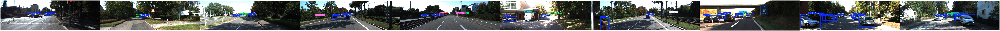

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os

# Define the directory where the predictions are saved
prediction_dir = 'runs/detect/predict'

# List all images in the prediction directory
images = os.listdir(prediction_dir)

# Display up to 10 images with predictions
num_images_to_display = min(10, len(images))  # Ensure we don't exceed the number of available images
fig, axes = plt.subplots(1, num_images_to_display, figsize=(200, 100))  # Create a row of subplots

for i in range(num_images_to_display):
    img_path = os.path.join(prediction_dir, images[i])  # Get image path
    img = mpimg.imread(img_path)  # Load the image
    axes[i].imshow(img)  # Show image on the corresponding subplot
    axes[i].axis('off')  # Disable axis for the subplot

plt.tight_layout()  # Adjust spacing between images
plt.show()



Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2025-1-3 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 


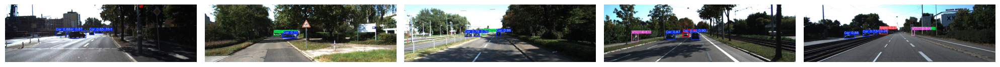

Image: 006182.jpg, Distances: []
Image: 001732.jpg, Distances: []
Image: 000683.jpg, Distances: []
Image: 001918.jpg, Distances: []
Image: 006849.jpg, Distances: []
Image: 000858.jpg, Distances: []
Image: 002623.jpg, Distances: [567.0702112478543, 1.0008113165040016, 568.0540770511392]
Image: 004742.jpg, Distances: [223.2669509210201, 461.57101573396784, 223.82773488499163, 461.1982248076057, 329.08630367328965, 376.9074306820308, 131.33925536563697, 238.30430301007272, 5.099178944742956, 237.95155144086905, 106.18185272481792, 154.0716469229037, 100.30261833340613, 237.844851538468, 4.0, 133.12229299177946, 86.35326173518224, 335.27738297330575, 237.40718903048383, 106.31203734572757, 154.14792566386492, 102.43503086789885, 133.12229299177946, 86.76915242357096, 335.27738297330575, 47.89145681973286, 202.16415026518766, 249.36480922039382]
Image: 003001.jpg, Distances: [718.6278672048697, 611.627419296256, 392.0840179748044, 127.71131963357533, 345.4284425460512, 225.75025829254378]
I

In [38]:
import os
import cv2
import numpy as np
import torch
from scipy.spatial.distance import euclidean
import matplotlib.pyplot as plt

# Load YOLOv5 model (using YOLOv5s as specified)
yolo_model = torch.hub.load('ultralytics/yolov5', 'yolov5s')

# Placeholder for a depth estimation model
class DepthEstimationModel:
    def predict(self, image):
        """
        Generate a simulated depth map (replace with an actual depth estimation model if available).
        """
        h, w = image.shape[:2]
        depth_map = np.linspace(30, 80, w).reshape(1, -1).repeat(h, axis=0)  # Depth gradient from 30m to 80m
        return depth_map

depth_model = DepthEstimationModel()

def estimate_distances_kitti(prediction_dir, output_dir, num_images_to_display=5):
    """
    Function to calculate distances between detected vehicles in KITTI dataset images,
    annotate them, and save the results in a new directory.

    Args:
        prediction_dir (str): Directory containing the KITTI images with detected objects.
        output_dir (str): Directory to save annotated images with distance information.
        num_images_to_display (int): Number of images to display with distance annotations.

    Returns:
        list: Distances between objects for each image.
    """
    # Ensure prediction directory exists
    if not os.path.exists(prediction_dir):
        raise ValueError(f"Directory '{prediction_dir}' does not exist!")

    images = [img for img in os.listdir(prediction_dir) if img.endswith(('png', 'jpg', 'jpeg'))]
    if not images:
        raise ValueError(f"No image files found in directory '{prediction_dir}'!")

    # Create the output directory if it doesn't exist
    os.makedirs(output_dir, exist_ok=True)

    all_distances = []  # Store distances for all images
    num_images_to_display = min(num_images_to_display, len(images))  # Limit images to display
    fig, axes = plt.subplots(1, num_images_to_display, figsize=(20, 10))

    for i, img_file in enumerate(images):
        img_path = os.path.join(prediction_dir, img_file)
        img = cv2.imread(img_path)
        if img is None:
            print(f"Warning: Could not load image at path '{img_path}'. Skipping...")
            continue

        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Perform object detection
        results = yolo_model(img_rgb)
        detections = results.xyxy[0].cpu().numpy()

        # Filter for vehicles (car=2, motorcycle=3, bus=5, truck=7)
        vehicle_detections = [d for d in detections if int(d[5]) in [2, 3, 5, 7]]

        # Generate depth map
        depth_map = depth_model.predict(img_rgb)

        # Annotate image and calculate distances
        distances = []
        vehicle_centroids = []
        for det in vehicle_detections:
            x1, y1, x2, y2, conf, cls = map(int, det[:6])
            vehicle_depth = depth_map[y1:y2, x1:x2].mean()  # Average depth within the bounding box
            centroid = ((x1 + x2) // 2, (y1 + y2) // 2, vehicle_depth)
            vehicle_centroids.append(centroid)

            # Draw bounding box and label
            label = f"{int(cls)}: {vehicle_depth:.1f}m"
            cv2.rectangle(img_rgb, (x1, y1), (x2, y2), (255, 0, 0), 2)
            cv2.putText(img_rgb, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

        # Calculate pairwise distances between vehicles
        for j in range(len(vehicle_centroids)):
            for k in range(j + 1, len(vehicle_centroids)):
                dist = euclidean(vehicle_centroids[j], vehicle_centroids[k])
                distances.append(dist)

        all_distances.append((img_file, distances))

        # Save the annotated image
        output_path = os.path.join(output_dir, img_file)
        cv2.imwrite(output_path, cv2.cvtColor(img_rgb, cv2.COLOR_RGB2BGR))

        # Display the annotated image
        if i < num_images_to_display:
            axes[i].imshow(img_rgb)
            axes[i].axis('off')

    plt.tight_layout()
    plt.show()

    return all_distances

# Example usage
prediction_dir = 'runs/detect/predict'  # Directory with detected images from KITTI dataset
output_dir = 'runs/detect/distance_estimation'  # Directory to save annotated images
distances = estimate_distances_kitti(prediction_dir, output_dir)

# Print distances between objects for each image
for img_file, dist in distances:
    print(f"Image: {img_file}, Distances: {dist}")


In [40]:
# After saving the annotated image, display them if needed
def display_images_from_directory(output_dir, num_images_to_display=5):
    """
    Function to display the saved annotated images from the output directory.

    Args:
        output_dir (str): Directory containing the annotated images.
        num_images_to_display (int): Number of images to display.
    """
    images = [img for img in os.listdir(output_dir) if img.endswith(('png', 'jpg', 'jpeg'))]
    if len(images) == 0:
        print(f"No images found in output directory '{output_dir}'.")
        return

    num_images_to_display = min(num_images_to_display, len(images))
    fig, axes = plt.subplots(1, num_images_to_display, figsize=(200, 50))

    for i, img_file in enumerate(images[:num_images_to_display]):
        img_path = os.path.join(output_dir, img_file)
        img = cv2.imread(img_path)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        axes[i].imshow(img_rgb)
        axes[i].axis('off')

    plt.tight_layout()
    plt.show()

# Example usage to display images after processing
display_images_from_directory(output_dir, num_images_to_display=10)
